<center><span style="color:#b30000;font-size:40px;"><strong>Epsilon Internship Project 3 </strong></span></center>
<center><span style="color:#b30000;font-size:30px;"><br>Customer Segmentation<br><br><strong>(Clustering 
    Phase)</strong></span></center>

<span style="color:#2929a3;font-size:20px;">Import Libraries</span>

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px

<span style="color:#2929a3;font-size:20px;">Read Dataset</span>

In [2]:
df = pd.read_csv('Data/Cleaned_Data_Merchant_Name.csv')

<span style="color:#2929a3;font-size:20px;">Show Sample of The Dataset </span>

In [3]:
df.head(5)

,Trx_Rank,Points,Trx_Vlu,Trx_Age,Customer_Age,Category In English,User_Id,Mer_Name
0,1,20140,2014.0,362,362,Fashion,21053,Shankar Traders
1,1,11200,1120.0,371,368,Fashion,26472,Shankar Traders
2,2,8500,850.0,368,368,Fashion,26472,Shankar Traders
3,1,1980,198.0,558,34,Fashion,27075,Shankar Traders
4,1,2400,240.0,413,413,Fashion,27417,Shankar Traders


<span style="color:#2929a3;font-size:20px;">Show Shape of Dataset </span>

In [4]:
df.shape

(43672, 8)

<span style="color:#2929a3;font-size:20px;">Check Data Info</span>

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43672 entries, 0 to 43671
Data columns (total 8 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Trx_Rank             43672 non-null  int64  
 1   Points               43672 non-null  int64  
 2   Trx_Vlu              43672 non-null  float64
 3   Trx_Age              43672 non-null  int64  
 4   Customer_Age         43672 non-null  int64  
 5   Category In English  43672 non-null  object 
 6   User_Id              43672 non-null  int64  
 7   Mer_Name             43672 non-null  object 
dtypes: float64(1), int64(5), object(2)
memory usage: 2.7+ MB


<span style="color:#2929a3;font-size:20px;">Check Null Values </span>

In [6]:
df.isnull().sum()

Trx_Rank               0
Points                 0
Trx_Vlu                0
Trx_Age                0
Customer_Age           0
Category In English    0
User_Id                0
Mer_Name               0
dtype: int64

<span style="color:#2929a3;font-size:20px;">Check Duplication </span>

In [7]:
df.duplicated().sum()

0

<span style="color:#b30000;font-size:30px;"><strong>Apply Univariate Analysis </strong></span>

<span style="color:#2929a3;font-size:20px;">1 - " Trx_Rank " column</span>

In [8]:
df['Trx_Rank'].describe()

count    43672.000000
mean         1.265227
std          0.776549
min          1.000000
25%          1.000000
50%          1.000000
75%          1.000000
max         17.000000
Name: Trx_Rank, dtype: float64

In [9]:
px.histogram(data_frame=df, x='Trx_Rank', text_auto=True)

<span style="color:#2929a3;font-size:20px;">2 - " Points " column</span>

In [10]:
df['Points'].describe()

count     43672.000000
mean       3312.249748
std        5756.374137
min          20.000000
25%        1220.000000
50%        1893.500000
75%        3100.000000
max      263800.000000
Name: Points, dtype: float64

In [11]:
px.histogram(data_frame=df, x='Points', text_auto=True)

<span style="color:#2929a3;font-size:20px;">3 - " Trx_Vlu " column</span>

In [12]:
df['Trx_Vlu'].describe()

count    43672.000000
mean       331.224975
std        575.637414
min          2.000000
25%        122.000000
50%        189.350000
75%        310.000000
max      26380.000000
Name: Trx_Vlu, dtype: float64

In [13]:
px.histogram(data_frame=df, x='Trx_Vlu', text_auto=True)

In [14]:
px.box(data_frame=df, x='Trx_Vlu')

In [15]:
## Ensuring that Points and Trx_Vlu columns is calculated correct
trx_value = df['Points'].apply(lambda x:np.round(x*0.1,1))
sum(trx_value != df['Trx_Vlu'])

0

In [16]:
## Check rows count in each category with Trx_Vlu greater than 600
df[df['Trx_Vlu'] > 600]['Category In English'].value_counts()

Category In English
Grocery            2945
F&B                 734
Fashion             576
Health & Beauty      93
Electronics          91
Transportaion        16
Other                13
Name: count, dtype: int64

In [17]:
## Check rows count in each category
df['Category In English'].value_counts()

Category In English
Grocery            30694
F&B                 7720
Fashion             3333
Health & Beauty     1504
Electronics          228
Transportaion        146
Other                 47
Name: count, dtype: int64

In [18]:
## Check Max Trx_Vlu in category F&B
df[df['Category In English'] == 'F&B']['Trx_Vlu'].max()

6122.0

In [19]:
## Check rows count in each category with Trx_Vlu less than 50
df[df['Trx_Vlu'] < 50]['Category In English'].value_counts()

Category In English
Grocery            1597
F&B                 257
Health & Beauty      78
Fashion              73
Other                10
Electronics           8
Transportaion         4
Name: count, dtype: int64

In [20]:
## Rows categorized as "Grocery" or "Transportation" with a Trx_Vlu greater than 600 will be replaced with the upper whisker value "600"
idx_above600 = df[(df['Category In English'].isin(['Grocery','Transportaion']) & (df['Trx_Vlu'] > 600))].index
df.loc[idx_above600]['Trx_Vlu'] = 600

In [21]:
## Rows categorized as "Health & Beauty" or "Fashion" or "Electronics" with Trx_Vlu less than 50 will be replaced with 50
idx_below50 = df[(df['Category In English'].isin(['Health & Beauty','Fashion','Electronics']) & (df['Trx_Vlu'] < 50))].index
df.loc[idx_below50]['Trx_Vlu'] = 50

<span style="color:#2929a3;font-size:20px;">4 - " Trx_Age " column</span>

In [22]:
df['Trx_Age'].describe()

count    43672.000000
mean       185.186664
std        121.989540
min          1.000000
25%         62.000000
50%        203.000000
75%        271.000000
max        698.000000
Name: Trx_Age, dtype: float64

In [23]:
px.histogram(data_frame=df, x='Trx_Age', text_auto=True)

<span style="color:#2929a3;font-size:20px;">5 - " Customer_Age " column</span>

In [24]:
df['Customer_Age'].describe()

count    43672.000000
mean       144.027844
std        114.764448
min          1.000000
25%         34.000000
50%        115.000000
75%        252.000000
max        682.000000
Name: Customer_Age, dtype: float64

In [25]:
px.histogram(data_frame=df, x='Customer_Age', text_auto=True)

In [26]:
## Ensuring that Customer_Age is always less than Trx_Age
df[df['Customer_Age'] > df['Trx_Age']]

,Trx_Rank,Points,Trx_Vlu,Trx_Age,Customer_Age,Category In English,User_Id,Mer_Name


<span style="color:#2929a3;font-size:20px;">6 - " Category In English " column</span>

In [27]:
df['Category In English'].unique()

array(['Fashion', 'F&B', 'Other', 'Grocery', 'Transportaion',
       'Electronics', 'Health & Beauty'], dtype=object)

In [28]:
df['Category In English'].value_counts()

Category In English
Grocery            30694
F&B                 7720
Fashion             3333
Health & Beauty     1504
Electronics          228
Transportaion        146
Other                 47
Name: count, dtype: int64

In [29]:
px.histogram(data_frame=df, x='Category In English', text_auto=True).update_xaxes(categoryorder='total descending')

<span style="color:#2929a3;font-size:20px;">7 - " User_Id " column</span>

In [30]:
df['User_Id'].nunique()

33457

In [31]:
df['User_Id'].value_counts()

User_Id
19390    29
13519    19
1238     19
4360     18
6573     17
         ..
7664      1
7661      1
7659      1
7657      1
16532     1
Name: count, Length: 33457, dtype: int64

<span style="color:#2929a3;font-size:20px;">8 - " Mer_Name " column</span>

In [32]:
df['Mer_Name'].nunique()

56

In [33]:
mer_series = df['Mer_Name'].value_counts()

In [34]:
## Include only merchants with frequecy greater than 100
merchants_to_use = mer_series[mer_series > 100].index.tolist()

In [35]:
df = df[df['Mer_Name'].isin(merchants_to_use)]

In [36]:
df.shape

(43105, 8)

In [37]:
df_merchant = df['Mer_Name'].value_counts().head(10).reset_index()

In [38]:
px.histogram(data_frame=df_merchant, x='Mer_Name', y='count', text_auto=True)

<span style="color:#2929a3;font-size:20px;"> Extract RFM(Recency, Frequecy, Monetary) from Original Dataframe </span>

In [39]:
## Extract RFM of each user for each Merchant
data_RFM = df.groupby(['User_Id','Mer_Name']).agg({'Trx_Age':lambda x:x.min(),
                                        'Trx_Rank':lambda x:x.nunique(),
                                        'Points':lambda x:x.sum()})
data_RFM.columns = ['Recency','Frequency','Monetary']

In [40]:
data_RFM.head()

,,Recency,Frequency,Monetary
User_Id,Mer_Name,,,
0,Jai Hind General Stores,281,1,4427
1,Agra Appliance Arena,34,1,2490
2,Amritsar Auto Accessories,236,1,3000
3,Agra Appliance Arena,320,1,1620
4,Ranchi Rug Retail,407,1,700


In [41]:
data_RFM.reset_index(level=['Mer_Name'], inplace=True)

In [42]:
data_RFM.head()

,Mer_Name,Recency,Frequency,Monetary
User_Id,,,,
0,Jai Hind General Stores,281,1,4427
1,Agra Appliance Arena,34,1,2490
2,Amritsar Auto Accessories,236,1,3000
3,Agra Appliance Arena,320,1,1620
4,Ranchi Rug Retail,407,1,700


In [43]:
data_RFM.shape

(35855, 4)

<span style="color:#b30000;font-size:30px;"><strong>Clustering Process </strong></span>

In [44]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, OneHotEncoder
from sklearn.pipeline import Pipeline
from category_encoders import BinaryEncoder
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import PCA

<span style="color:#2929a3;font-size:25px;">KMeans Model</span>

In [45]:
## Create Copy of data_RFM
df_RFM = data_RFM.copy()

In [46]:
encoder = ColumnTransformer(transformers=[('encoder',BinaryEncoder(), ['Mer_Name'])], remainder='passthrough')

In [47]:
Scalers = []
Scalers.append(('Standard_Scaler',StandardScaler()))
Scalers.append(('Min_Max_Scaler',MinMaxScaler()))
Scalers.append(('Robust_Scaler',RobustScaler()))

In [48]:
kMeans_Inertia_dict = {"Standard_Scaler":[], "Min_Max_Scaler":[], "Robust_Scaler":[]}
KMeans_Silhouette_dict = {"Standard_Scaler":[], "Min_Max_Scaler":[], "Robust_Scaler":[]}
k_values = range(2,15)
for scaler in Scalers:
    for k in k_values:
        steps=[]
        steps.append(('encoder',encoder))
        steps.append(scaler)
        steps.append(('Kmeans',KMeans(n_clusters=k, n_init=10)))
        pipeline = Pipeline(steps= steps)
        pipeline.fit(df_RFM)
        kMeans_Inertia_dict[scaler[0]].append(pipeline['Kmeans'].inertia_)
        KMeans_Silhouette_dict[scaler[0]].append(silhouette_score(pipeline[:2].fit_transform(df_RFM), pipeline['Kmeans'].labels_))

In [49]:
px.line(x=k_values, y=[kMeans_Inertia_dict['Standard_Scaler'],kMeans_Inertia_dict['Min_Max_Scaler'],kMeans_Inertia_dict['Robust_Scaler']])

In [50]:
px.line(x=k_values, y=kMeans_Inertia_dict['Min_Max_Scaler'])

In [51]:
## Show elbow with KneeLocator
from kneed import KneeLocator
k1 = KneeLocator(k_values, kMeans_Inertia_dict['Min_Max_Scaler'], direction='decreasing', curve='convex')
k1.all_elbows

{6}

In [52]:
px.line(x=k_values, y=[KMeans_Silhouette_dict['Standard_Scaler'],KMeans_Silhouette_dict['Min_Max_Scaler'],KMeans_Silhouette_dict['Robust_Scaler']])

In [53]:
## Create Pipeline with KMeans Model
steps=[]
steps.append(('encoder', encoder))
steps.append(('Scaler',MinMaxScaler()))
steps.append(('Kmeans',KMeans(n_clusters=3, n_init=10)))
pipeline = Pipeline(steps= steps)
pipeline.fit(df_RFM)

Pipeline(steps=[('encoder',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('encoder', BinaryEncoder(),
                                                  ['Mer_Name'])])),
                ('Scaler', MinMaxScaler()),
                ('Kmeans', KMeans(n_clusters=3, n_init=10))])

In [54]:
## Add Clusters to df_RFM
df_RFM['Cluster'] = pipeline['Kmeans'].labels_

In [55]:
## Check Value Counts of each Cluster
df_RFM['Cluster'].value_counts()

Cluster
0    19024
2    11075
1     5756
Name: count, dtype: int64

In [56]:
## Apply PCA to reduce dimensionality and visualize clusters
steps= []
steps.append(('encoder', encoder))
steps.append(('Scaler',MinMaxScaler()))
steps.append(('PCA',PCA(n_components=2, random_state=7)))
pipeline = Pipeline(steps= steps)

In [57]:
df_pca = pd.DataFrame(pipeline.fit_transform(df_RFM), columns=['PCA1','PCA2'])

In [58]:
pipeline['PCA'].explained_variance_ratio_.sum()

0.8038949954375223

In [59]:
## Add Clusters to df_pca
df_pca['Cluster'] = df_RFM['Cluster'].values

In [60]:
## Visualize Clusters
px.scatter(data_frame=df_pca, x='PCA1', y='PCA2', color='Cluster')

<span style="color:#2929a3;font-size:25px;">Hierarcial Clustering Model</span>

In [81]:
## Create Copy of data_RFM 
df_RFM_hier = data_RFM.copy()

In [82]:
encoder = ColumnTransformer(transformers=[('encoder',BinaryEncoder(), ['Mer_Name'])], remainder='passthrough')

In [83]:
Scalers = []
Scalers.append(('Standard_Scaler',StandardScaler()))
Scalers.append(('Min_Max_Scaler',MinMaxScaler()))
Scalers.append(('Robust_Scaler',RobustScaler()))

In [91]:
## Claculate Silhouette Score with different Scalers and different K values
Hierarcial_Silhouette_dict = {"Standard_Scaler":[], "Min_Max_Scaler":[], "Robust_Scaler":[]}
k_values = range(2,15)
for scaler in Scalers:
    for k in k_values:
        steps=[]
        steps.append(('encoder',encoder))
        steps.append(scaler)
        steps.append(('Hierarcial Clustering',AgglomerativeClustering(n_clusters=k)))
        pipeline = Pipeline(steps= steps)
        pipeline.fit(df_RFM_hier)
        Hierarcial_Silhouette_dict[scaler[0]].append(silhouette_score(pipeline[:2].fit_transform(df_RFM_hier), pipeline['Hierarcial Clustering'].labels_))

In [92]:
## Visualize Silhoute Scores
px.line(x=k_values, y=[Hierarcial_Silhouette_dict['Standard_Scaler'],Hierarcial_Silhouette_dict['Min_Max_Scaler'],Hierarcial_Silhouette_dict['Robust_Scaler']])

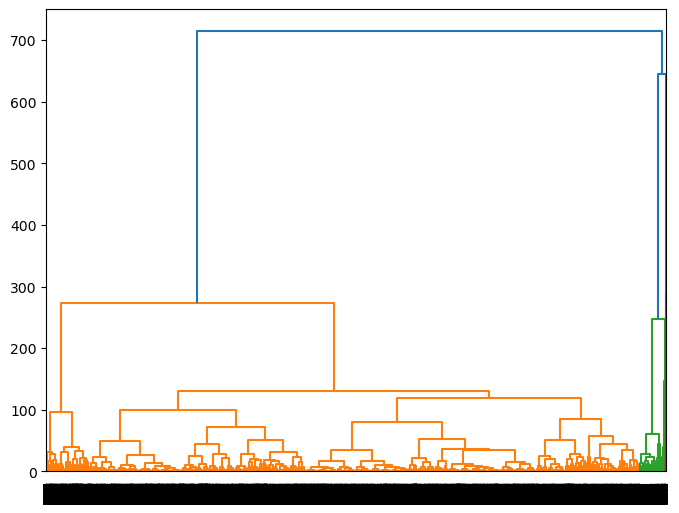

In [93]:
## Draw Dendogram
import scipy.cluster.hierarchy as sch
import matplotlib.pyplot as plt

df_scaled = pd.DataFrame(pipeline[:2].fit_transform(df_RFM_hier), columns=pipeline[:2].get_feature_names_out())

plt.figure(figsize=(8,6))
dendo = sch.dendrogram(sch.linkage(df_scaled, method='ward'))
plt.show()

In [94]:
## Create Pipeline with Hierarcial Clustering Model
steps=[]
steps.append(('encoder', encoder))
steps.append(('Scaler',MinMaxScaler()))
steps.append(('Hierarcial Clustering',AgglomerativeClustering(n_clusters=3)))
pipeline = Pipeline(steps= steps)
pipeline.fit(df_RFM_hier)

Pipeline(steps=[('encoder',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('encoder', BinaryEncoder(),
                                                  ['Mer_Name'])])),
                ('Scaler', MinMaxScaler()),
                ('Hierarcial Clustering',
                 AgglomerativeClustering(n_clusters=3))])

In [95]:
## Add Clusters to df_RFM_hier
df_RFM_hier['Cluster'] = pipeline['Hierarcial Clustering'].labels_

In [96]:
## Check Value Counts of each Cluster
df_RFM_hier['Cluster'].value_counts()

Cluster
0    18624
1    10815
2     6416
Name: count, dtype: int64

In [97]:
## Apply PCA to reduce dimensionality and visualize clusters
steps= []
steps.append(('encoder', encoder))
steps.append(('Scaler',MinMaxScaler()))
steps.append(('PCA',PCA(n_components=2)))
pipeline = Pipeline(steps= steps)
df_pca_hier = pd.DataFrame(pipeline.fit_transform(df_RFM_hier), columns=['PCA1','PCA2'])

In [98]:
pipeline['PCA'].explained_variance_ratio_.sum()

0.7830317613225676

In [99]:
## Add Clusters to df_pca_hier
df_pca_hier['Cluster'] = df_RFM_hier['Cluster'].values

In [100]:
## Visualize Clusters
px.scatter(data_frame=df_pca_hier, x='PCA1', y='PCA2', color='Cluster')

<span style="color:#2929a3;font-size:25px;">DBSCAN Model</span>

In [70]:
from sklearn.cluster import DBSCAN

In [71]:
## Create Copy of data_RFM 
df_RFM_DB = data_RFM.copy()

In [72]:
encoder = ColumnTransformer(transformers=[('encoder',BinaryEncoder(), ['Mer_Name'])], remainder='passthrough')

In [73]:
## Create Pipeline with DBSCAN Model
steps=[]
steps.append(('encoder',encoder))
steps.append(('scaler',MinMaxScaler()))
steps.append(('DBSCAN',DBSCAN(min_samples=4000)))
pipeline = Pipeline(steps= steps)
pipeline.fit(df_RFM_DB)

Pipeline(steps=[('encoder',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('encoder', BinaryEncoder(),
                                                  ['Mer_Name'])])),
                ('scaler', MinMaxScaler()),
                ('DBSCAN', DBSCAN(min_samples=4000))])

In [74]:
## Check Value of Silhoute
silhouette_score(pipeline[:2].fit_transform(df_RFM_DB), pipeline['DBSCAN'].labels_)

0.5548276420959826

In [75]:
## Add Clusters to df_RFM_DB
df_RFM_DB['Cluster'] = pipeline['DBSCAN'].labels_

In [76]:
## Check Value Counts of each Cluster
df_RFM_DB['Cluster'].value_counts()

Cluster
 0    15932
-1    13739
 1     6184
Name: count, dtype: int64

In [77]:
## Apply PCA to reduce dimensionality and visualize clusters
steps= []
steps.append(('encoder', encoder))
steps.append(('Scaler',MinMaxScaler()))
steps.append(('PCA',PCA(n_components=2)))
pipeline = Pipeline(steps= steps)
df_pca_DB = pd.DataFrame(pipeline.fit_transform(df_RFM_DB), columns=['PCA1','PCA2'])

In [78]:
pipeline['PCA'].explained_variance_ratio_.sum()

0.7755573046788669

In [79]:
## Add Clusters to df_pca_DB
df_pca_DB['Cluster'] = df_RFM_DB['Cluster'].values

In [80]:
## Visualize Clusters
px.scatter(data_frame=df_pca_DB, x='PCA1', y='PCA2', color='Cluster')

## Note
#### All pipelines share the same name "pipeline", so when executing any section of code, ensure that you are using the correct pipeline

<span style="color:#2929a3;font-size:25px;">Create Final Model</span><br><br>
<span style="color:#2929a3;font-size:17px;">Model : KMeans</span><br>
<span style="color:#2929a3;font-size:17px;">K : 3</span><br>
<span style="color:#2929a3;font-size:17px;">Scaler : MinMaxScaler</span><br>

In [85]:
df_RFM_final = data_RFM.copy()

In [86]:
encoder = ColumnTransformer(transformers=[('encoder',BinaryEncoder(), ['Mer_Name'])], remainder='passthrough')

In [87]:
steps=[]
steps.append(('Encoder', encoder))
steps.append(('Scaler',MinMaxScaler()))
steps.append(('Final_KMeans',KMeans(n_clusters=3, n_init=10)))
pipeline = Pipeline(steps= steps)
pipeline.fit(df_RFM_final)

Pipeline(steps=[('Encoder',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('encoder', BinaryEncoder(),
                                                  ['Mer_Name'])])),
                ('Scaler', MinMaxScaler()),
                ('Final_KMeans', KMeans(n_clusters=3, n_init=10))])

In [88]:
df_RFM_final['Cluster'] = pipeline['Final_KMeans'].labels_

In [89]:
df_RFM_final.head()

,Mer_Name,Recency,Frequency,Monetary,Cluster
User_Id,,,,,
0,Jai Hind General Stores,281,1,4427,0
1,Agra Appliance Arena,34,1,2490,2
2,Amritsar Auto Accessories,236,1,3000,2
3,Agra Appliance Arena,320,1,1620,2
4,Ranchi Rug Retail,407,1,700,0


<span style="color:#2929a3;font-size:25px;">Save Final Dataframe</span><br><br>

In [102]:
#df_RFM_final.to_pickle('Data/df_RFM_final2.pkl')